### Display the some first `image_file_names` & `file_name.csv`

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

## print out the names of the first 5 image_files (total = 10 images for train_imgaes & train_label_masks) with the train, test, submission.csv files
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames[:5]:
        print(os.path.join(dirname, filename))

/kaggle/input/prostate-cancer-grade-assessment/sample_submission.csv
/kaggle/input/prostate-cancer-grade-assessment/test.csv
/kaggle/input/prostate-cancer-grade-assessment/train.csv
/kaggle/input/prostate-cancer-grade-assessment/train_images/a05ded7fe107cfdfcfc8f644fb2d7313.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/72e64850d127c65815492af84473a26e.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/274187a867ebf7834ab44372da776439.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/a08e24cff451d628df797efc4343e13c.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_images/b7540ad7f233e9c19a6cb083945072fd.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_label_masks/aa7000449538fe951e1c0dadc7ce9b44_mask.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_label_masks/d63c41a88f43f4f46b49fe4d63c9d117_mask.tiff
/kaggle/input/prostate-cancer-grade-assessment/train_label_masks/b083e93e44742431259b7bf6f4df2000_mask.tiff
/kag

### Basic libraries

In [2]:
import os

# There are two ways to load the data from the PANDA dataset:
# Option 1: Load images using openslide
import openslide
# Option 2: Load images using skimage (requires that tifffile is installed)
import skimage.io
import random
import seaborn as sns
import cv2

# General packages
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import PIL
from IPython.display import Image, display

# Plotly for the interactive viewer (see last section)
import plotly.graph_objs as go

### Loading & viewing dataset

In [3]:
# Location of the training images

BASE_PATH = '../input/prostate-cancer-grade-assessment'

# image and mask directories
data_dir = f'{BASE_PATH}/train_images'
mask_dir = f'{BASE_PATH}/train_label_masks'


# Location of training labels
train = pd.read_csv(f'{BASE_PATH}/train.csv').set_index('image_id')
test = pd.read_csv(f'{BASE_PATH}/test.csv')

train_labels = pd.read_csv('/kaggle/input/prostate-cancer-grade-assessment/train.csv').set_index('image_id')

submission = pd.read_csv(f'{BASE_PATH}/sample_submission.csv')

In [4]:
train.head()

,data_provider,isup_grade,gleason_score
image_id,,,
0005f7aaab2800f6170c399693a96917,karolinska,0,0+0
000920ad0b612851f8e01bcc880d9b3d,karolinska,0,0+0
0018ae58b01bdadc8e347995b69f99aa,radboud,4,4+4
001c62abd11fa4b57bf7a6c603a11bb9,karolinska,4,4+4
001d865e65ef5d2579c190a0e0350d8f,karolinska,0,0+0


In [5]:
print("Shape of training data :", train.shape)
print("Mainly information of training data :", train.info())
print("unique data provider :", len(train.data_provider.unique()))
print("unique isup_grade(target) :", len(train.isup_grade.unique()))
print("unique gleason_score :", len(train.gleason_score.unique()))

Shape of training data : (10616, 3)
<class 'pandas.core.frame.DataFrame'>
Index: 10616 entries, 0005f7aaab2800f6170c399693a96917 to ffe9bcababc858e04840669e788065a1
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   data_provider  10616 non-null  object
 1   isup_grade     10616 non-null  int64 
 2   gleason_score  10616 non-null  object
dtypes: int64(1), object(2)
memory usage: 331.8+ KB
Mainly information of training data : None
unique data provider : 2
unique isup_grade(target) : 6
unique gleason_score : 11


In [6]:
test.head()

,image_id,data_provider
0,005700be7e06878e6605e7a5a39de1b2,radboud
1,005c6e8877caf724c600fdce5d417d40,karolinska
2,0104f76634ff89bfff1ef0804a95c380,radboud


In [7]:
submission.head()

,image_id,isup_grade
0,005700be7e06878e6605e7a5a39de1b2,0
1,005c6e8877caf724c600fdce5d417d40,0
2,0104f76634ff89bfff1ef0804a95c380,0


### 1. Loading & displaying a list of images & mask_images by using `openslide()`

#### 1.1. `display_images`, storing in `data_dir`

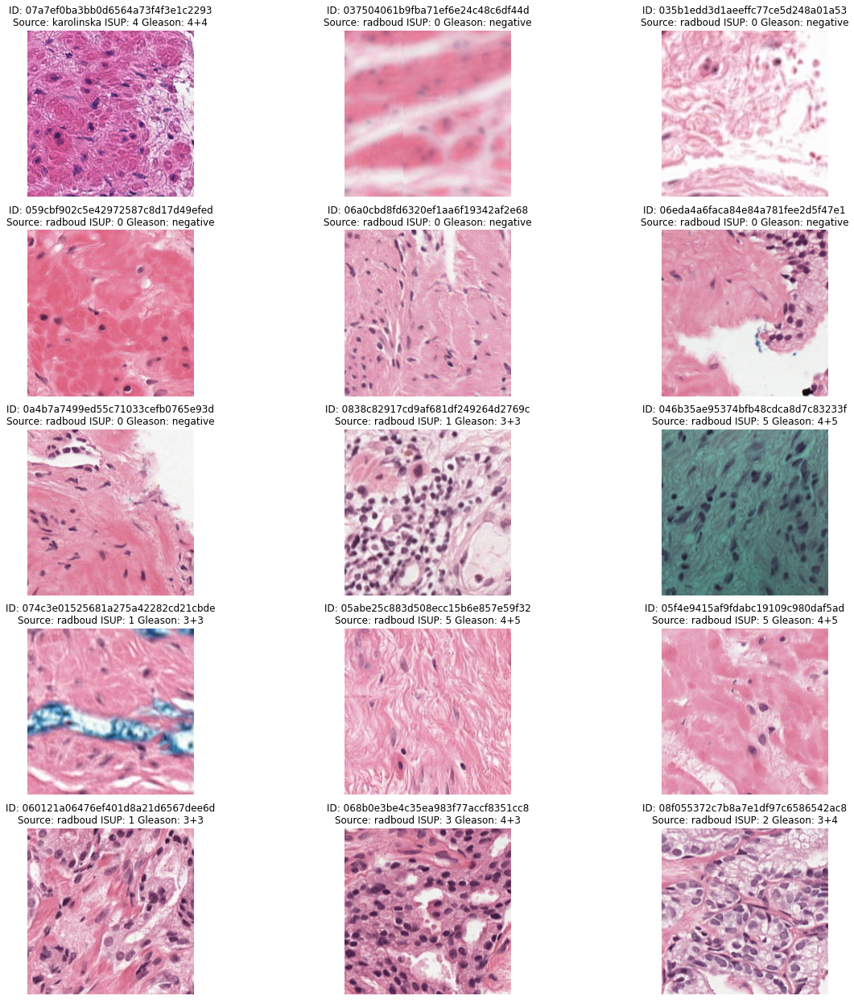

In [8]:
def display_images(slides): 
    f, ax = plt.subplots(5,3, figsize=(20, 22))
    for i, slide in enumerate(slides):
        image = openslide.OpenSlide(os.path.join(data_dir, f'{slide}.tiff'))
        spacing = 1 / (float(image.properties['tiff.XResolution']) / 10000)
        patch = image.read_region((1780,1950), 0, (256, 256))
        ax[i//3, i%3].imshow(patch) 
        image.close()       
        ax[i//3, i%3].axis('off')
        
        image_id = slide
        data_provider = train.loc[slide, 'data_provider']
        isup_grade = train.loc[slide, 'isup_grade']
        gleason_score = train.loc[slide, 'gleason_score']
        ax[i//3, i%3].set_title(f"ID: {image_id}\nSource: {data_provider} ISUP: {isup_grade} Gleason: {gleason_score}")

    plt.show() 
    
images = [
    '07a7ef0ba3bb0d6564a73f4f3e1c2293',
    '037504061b9fba71ef6e24c48c6df44d',
    '035b1edd3d1aeeffc77ce5d248a01a53',
    '059cbf902c5e42972587c8d17d49efed',
    '06a0cbd8fd6320ef1aa6f19342af2e68',
    '06eda4a6faca84e84a781fee2d5f47e1',
    '0a4b7a7499ed55c71033cefb0765e93d',
    '0838c82917cd9af681df249264d2769c',
    '046b35ae95374bfb48cdca8d7c83233f',
    '074c3e01525681a275a42282cd21cbde',
    '05abe25c883d508ecc15b6e857e59f32',
    '05f4e9415af9fdabc19109c980daf5ad',
    '060121a06476ef401d8a21d6567dee6d',
    '068b0e3be4c35ea983f77accf8351cc8',
    '08f055372c7b8a7e1df97c6586542ac8'
]

display_images(images)

#### 1.2. `display_masks` or (`mask_images`, storing in `mask_dir`)

Noting that the 

            (filename_in_mask_dir = filename_in_data_dir + _mask).tiff

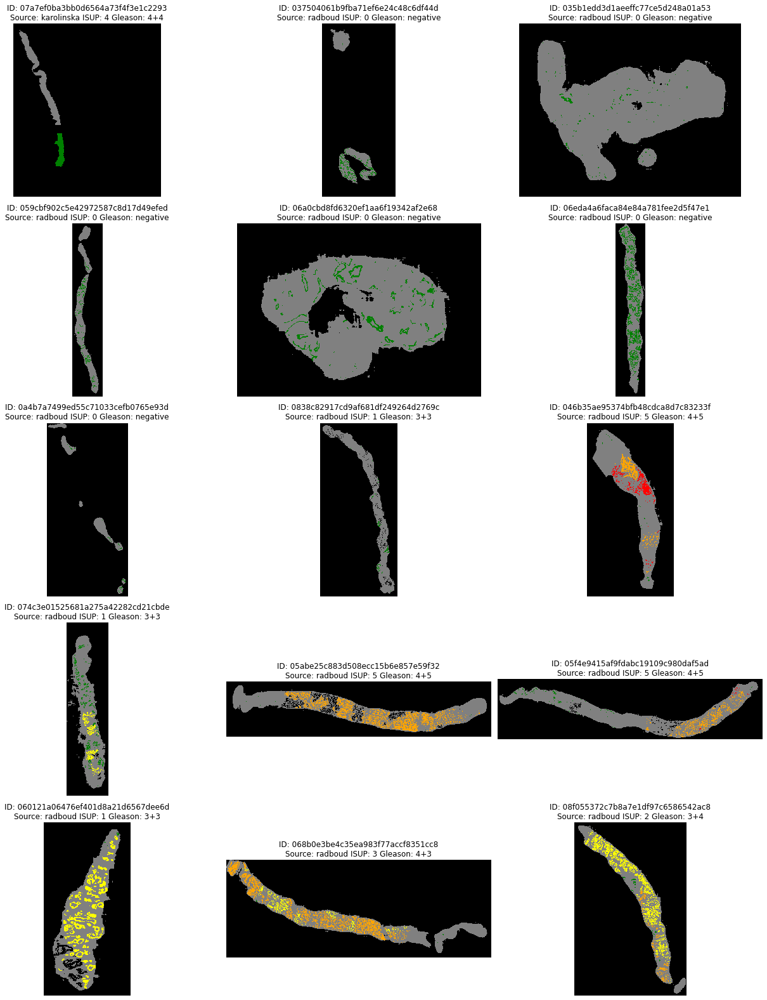

In [9]:
def display_masks(slides): 
    f, ax = plt.subplots(5,3, figsize=(18,22))
    for i, slide in enumerate(slides):
        
        mask = openslide.OpenSlide(os.path.join(mask_dir, f'{slide}_mask.tiff'))
        mask_data = mask.read_region((0,0), mask.level_count - 1, mask.level_dimensions[-1])
        cmap = matplotlib.colors.ListedColormap(['black', 'gray', 'green', 'yellow', 'orange', 'red'])

        ax[i//3, i%3].imshow(np.asarray(mask_data)[:,:,0], cmap=cmap, interpolation='nearest', vmin=0, vmax=5) 
        mask.close()       
        ax[i//3, i%3].axis('off')
        
        image_id = slide
        data_provider = train.loc[slide, 'data_provider']
        isup_grade = train.loc[slide, 'isup_grade']
        gleason_score = train.loc[slide, 'gleason_score']
        ax[i//3, i%3].set_title(f"ID: {image_id}\nSource: {data_provider} ISUP: {isup_grade} Gleason: {gleason_score}")
        f.tight_layout()
        
    plt.show()
    
display_masks(images)

### 2. Split the images using `grid`

#### 2.1. Drafting idea.

Firstly, we will look back the function `skimage.io.MultiImage(path_file)`

In [10]:
import skimage
img_data = skimage.io.MultiImage(os.path.join(data_dir, '004dd32d9cd167d9cc31c13b704498af.tiff'))
img_mask = skimage.io.MultiImage(os.path.join(mask_dir, '004dd32d9cd167d9cc31c13b704498af_mask.tiff'))
len(img_mask), len(img_data)

(3, 3)

The vrs `img_mask` returns 3 values corresponding to 3 `levels` of the mask_image `'004dd32d9cd167d9cc31c13b704498af_mask.tiff'` if we use `openslide.read.region()`

In [11]:
image = openslide.OpenSlide(os.path.join(data_dir, '004dd32d9cd167d9cc31c13b704498af.tiff'))
print(image.level_count)
print(image.dimensions)
print(image.level_dimensions)
print(image.level_downsamples)

3
(8192, 22528)
((8192, 22528), (2048, 5632), (512, 1408))
(1.0, 4.0, 16.0)


In [12]:
for idx, level in enumerate(img_mask):
    print('Level_downsample:', str(image.level_downsamples[idx]), '\t data_img_shape(w, h) with openslide: ',
          image.level_dimensions[idx], ', \t data_img_shape(h, w) with ski:', img_data[idx].shape)
    print('\t \t \t mask_img_shape(w, h) with openslide: ',
          image.level_dimensions[idx], ', \t mask_img_shape(h, w) with ski:', img_mask[idx].shape)
    print('\t \t \t data_img: \t min_pixel_value:', img_mask[idx].min(), '\t max_pixel_value:', img_data[idx].max(), 
          ', \t memory size: ', int(img_data[idx].nbytes / (2**20)), 'MB')
    print('\t \t \t mask_img: \t min_pixel_value:', img_mask[idx].min(), '\t max_pixel_value:', img_mask[idx].max(),
          ', \t\t memory size: ', int(level.nbytes/ (2**20)), 'MB \n')   

Level_downsample: 1.0 	 data_img_shape(w, h) with openslide:  (8192, 22528) , 	 data_img_shape(h, w) with ski: (22528, 8192, 3)
	 	 	 mask_img_shape(w, h) with openslide:  (8192, 22528) , 	 mask_img_shape(h, w) with ski: (22528, 8192, 3)
	 	 	 data_img: 	 min_pixel_value: 0 	 max_pixel_value: 255 , 	 memory size:  528 MB
	 	 	 mask_img: 	 min_pixel_value: 0 	 max_pixel_value: 2 , 		 memory size:  528 MB 

Level_downsample: 4.0 	 data_img_shape(w, h) with openslide:  (2048, 5632) , 	 data_img_shape(h, w) with ski: (5632, 2048, 3)
	 	 	 mask_img_shape(w, h) with openslide:  (2048, 5632) , 	 mask_img_shape(h, w) with ski: (5632, 2048, 3)
	 	 	 data_img: 	 min_pixel_value: 0 	 max_pixel_value: 255 , 	 memory size:  33 MB
	 	 	 mask_img: 	 min_pixel_value: 0 	 max_pixel_value: 2 , 		 memory size:  33 MB 

Level_downsample: 16.0 	 data_img_shape(w, h) with openslide:  (512, 1408) , 	 data_img_shape(h, w) with ski: (1408, 512, 3)
	 	 	 mask_img_shape(w, h) with openslide:  (512, 1408) , 	 mas

Since the `pixel_values` in [0, 2], so we will firstly multiply it to 125 to get the values in [0, 250]. Then, display all of them

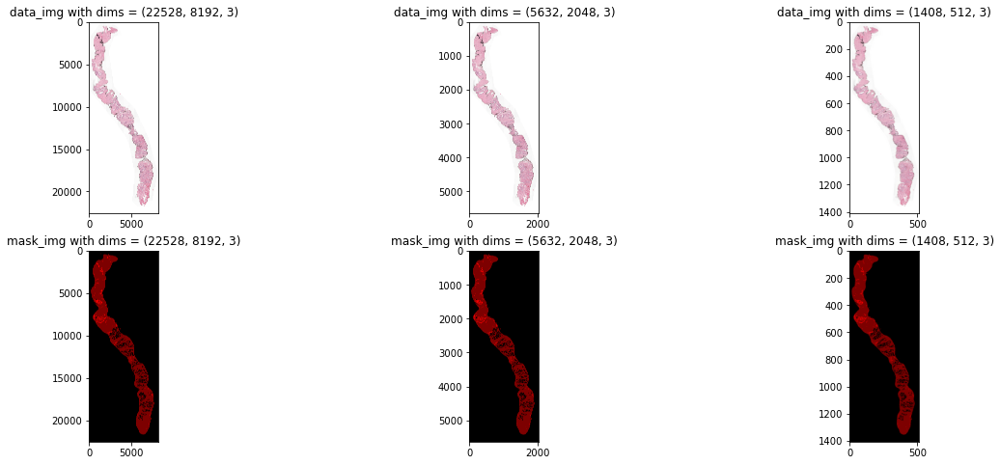

In [13]:
plt.figure(figsize = (20, 8))
for k in range(len(img_mask)):
    plt.subplot(2, 3, k+4)
    plt.imshow(img_mask[k] * 125)
    plt.title('mask_img with dims = ' + str(img_mask[k].shape))
    plt.subplot(2, 3, k+1)
    plt.imshow(img_data[k])
    plt.title('data_img with dims = ' + str(img_data[k].shape))

In [14]:
from skimage.io import imread
import imagecodecs

%time img = imread(os.path.join(data_dir, '004dd32d9cd167d9cc31c13b704498af.tiff'))
img.shape

CPU times: user 1.08 s, sys: 201 ms, total: 1.28 s
Wall time: 1.28 s


(22528, 8192, 3)

CPU times: user 2.08 s, sys: 196 ms, total: 2.28 s
Wall time: 2.28 s


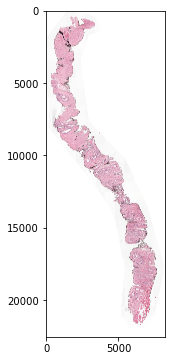

In [15]:
plt.figure(figsize = (10, 6))
%time plt.imshow(img)

width_start_at: 0 	 width_end_at: 11264 	 height_start_at: 0 	 height_end_at: 2730 	 No_img: 1
width_start_at: 0 	 width_end_at: 11264 	 height_start_at: 2730 	 height_end_at: 5461 	 No_img: 3
width_start_at: 0 	 width_end_at: 11264 	 height_start_at: 5461 	 height_end_at: 8192 	 No_img: 5
width_start_at: 11264 	 width_end_at: 22528 	 height_start_at: 0 	 height_end_at: 2730 	 No_img: 2
width_start_at: 11264 	 width_end_at: 22528 	 height_start_at: 2730 	 height_end_at: 5461 	 No_img: 4
width_start_at: 11264 	 width_end_at: 22528 	 height_start_at: 5461 	 height_end_at: 8192 	 No_img: 6


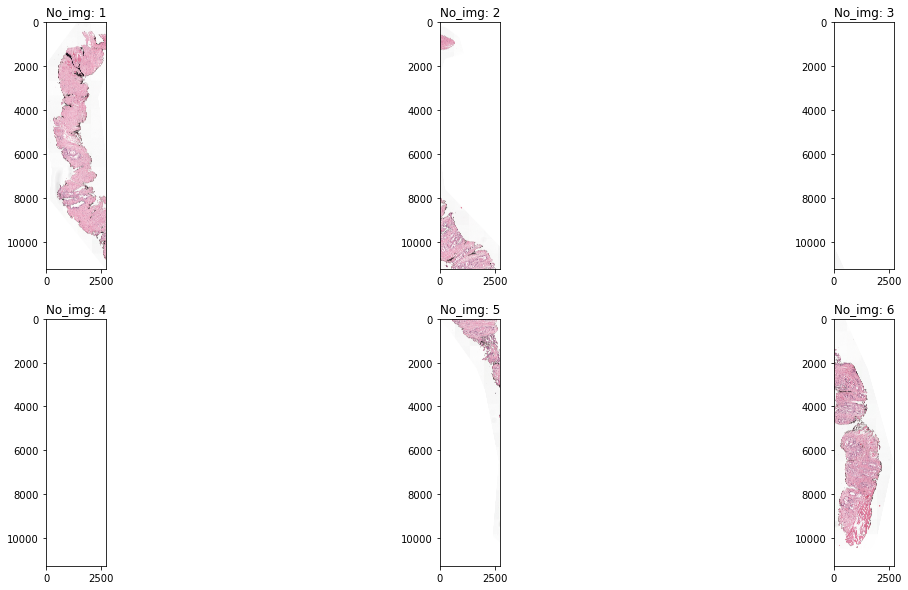

In [16]:
nr, nc = 2, 3
h, w = img.shape[: 2]
img_ls = []
for i in range(nr):
    for j in range(nc):
        print('width_start_at:', int(i*h/nr), '\t width_end_at:' , int((i+1)*h/nr), '\t height_start_at:', int(j*w/nc) , '\t height_end_at:', int((j+1)*w/nc), '\t No_img:', j*nr+ i + 1)
        img_ls.append(img[ int(i*h/nr) : int((i+1)*h/nr), int(j*w/nc) : int((j+1)*w/nc), :])

plt.figure(figsize = (20, 10))
for i in range(nr*nc):
    plt.subplot(nr, nc, i + 1)
    plt.imshow(img_ls[i])
    plt.title('No_img: ' + str(i + 1))

#### Build a function for spliting

CPU times: user 2.17 s, sys: 210 ms, total: 2.38 s
Wall time: 2.38 s


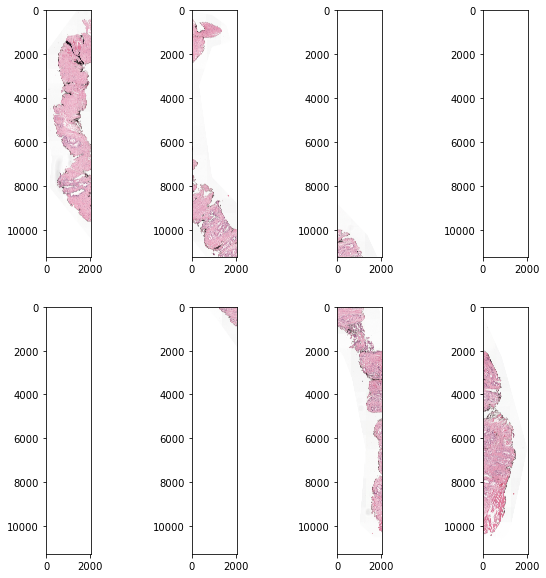

In [17]:
def display_img_spliting(img, nr, nc, fs):
    ## img : image source
    ## nr, nc : number of rows & columns at the subplot for spliting
    ## fs: figsize
    h, w = img.shape[: 2]
    img_ls = []
    for i in range(nr):
        for j in range(nc):
            img_ls.append(img[ int(i*h/nr) : int((i+1)*h/nr), int(j*w/nc) : int((j+1)*w/nc), :])

    plt.figure(figsize = fs)
    for i in range(nr*nc):
        plt.subplot(nr, nc, i + 1)
        plt.imshow(img_ls[i])
        
%time display_img_spliting(img, 2, 4, (10, 10))

CPU times: user 2.8 s, sys: 174 ms, total: 2.98 s
Wall time: 2.98 s


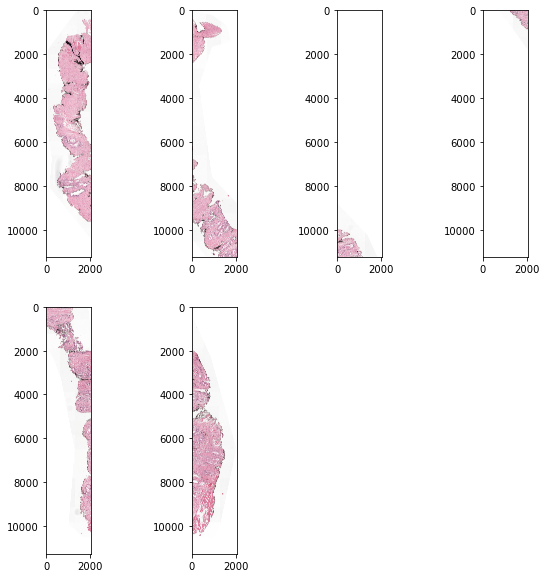

In [18]:
def display_img_spliting_v2(img, nr, nc, fs):
    ## img : image source
    ## nr, nc : number of rows & columns at the subplot for spliting
    ## fs: figsize
    h, w = img.shape[: 2]
    img_ls = []
    for i in range(nr):
        for j in range(nc):
            image = img[ int(i*h/nr) : int((i+1)*h/nr), int(j*w/nc) : int((j+1)*w/nc), :]
            if image.min() != image.max():
                img_ls.append(image)

    plt.figure(figsize = fs)
    for i in range(len(img_ls)):
        plt.subplot(nr, nc, i + 1)
        plt.imshow(img_ls[i])
        
%time display_img_spliting_v2(img, 2, 4, (10, 10))

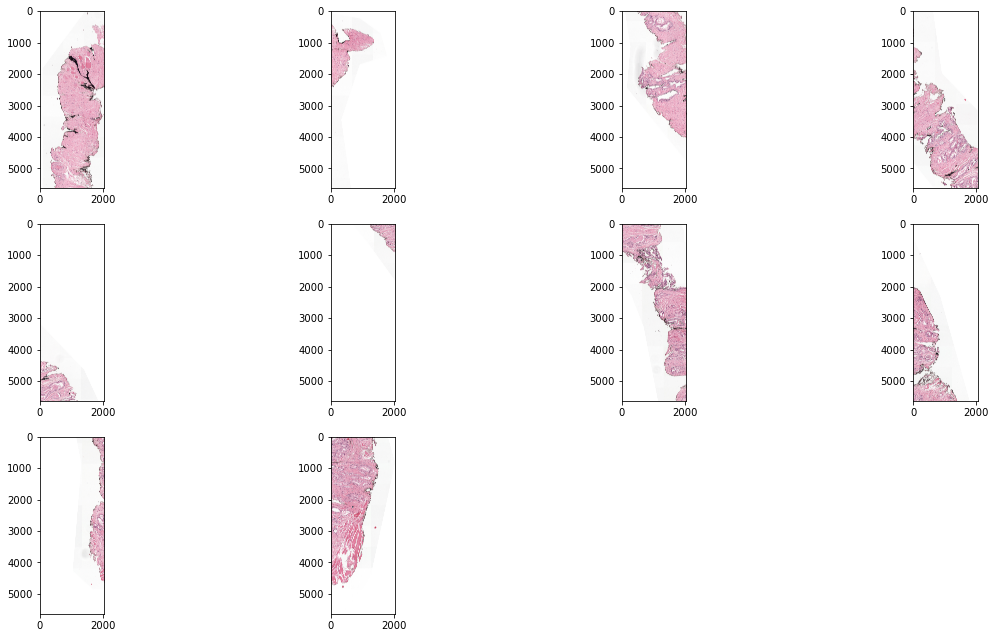

In [19]:
display_img_spliting_v2(img, 4, 4, (20, 15))


spliting with a given_size; such as default = 256

In [20]:
def spliting_image(img, ws = 256, hs = 256):
    """
    Input:  img : image source
            ws, hs : width_size & height_size per image
    return: list of images
    """
    h, w = img.shape[: 2]
    nc = int(w / ws)
    nr = int(h / hs)
    img_ls = []
    for i in range(nr):
        for j in range(nc):
            image = img[ int(i*ws) : int((i+1)*ws), int(j*hs) : int((j+1)*hs), :]
            if image.min() != image.max():
                img_ls.append(image)
                
    return img_ls
        
x = spliting_image(img)

In [21]:
x[0].shape, x[-1].shape, len(x), type(x), type(x[0])

((256, 256, 3), (256, 256, 3), 1023, list, numpy.ndarray)

#### Display overall `split_img`

CPU times: user 26 s, sys: 280 ms, total: 26.3 s
Wall time: 26.4 s


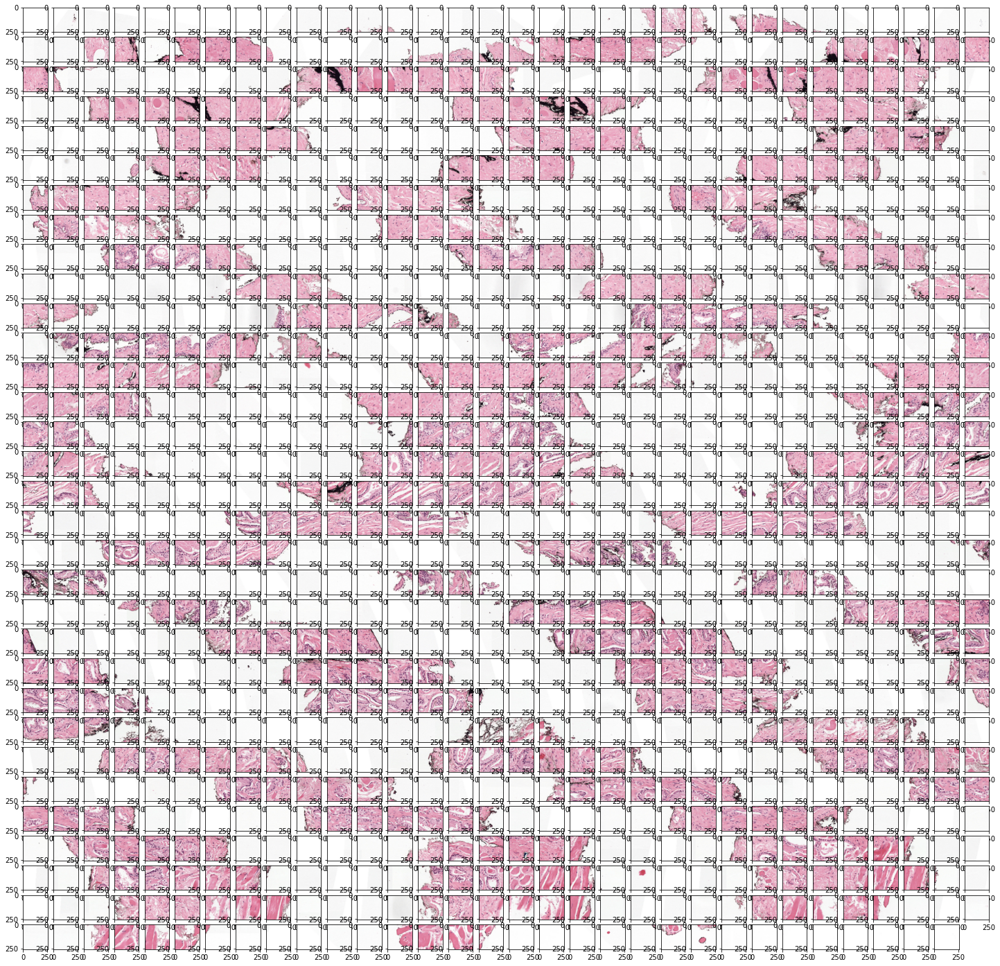

In [22]:
def test_and_count_time():
    plt.figure(figsize = (25, 25))
    for i in range(len(x)):
        plt.subplot(32, 32, i + 1)
        plt.imshow(x[i])
%time test_and_count_time()

#### Randomly display split_img

CPU times: user 260 ms, sys: 1.88 ms, total: 261 ms
Wall time: 262 ms


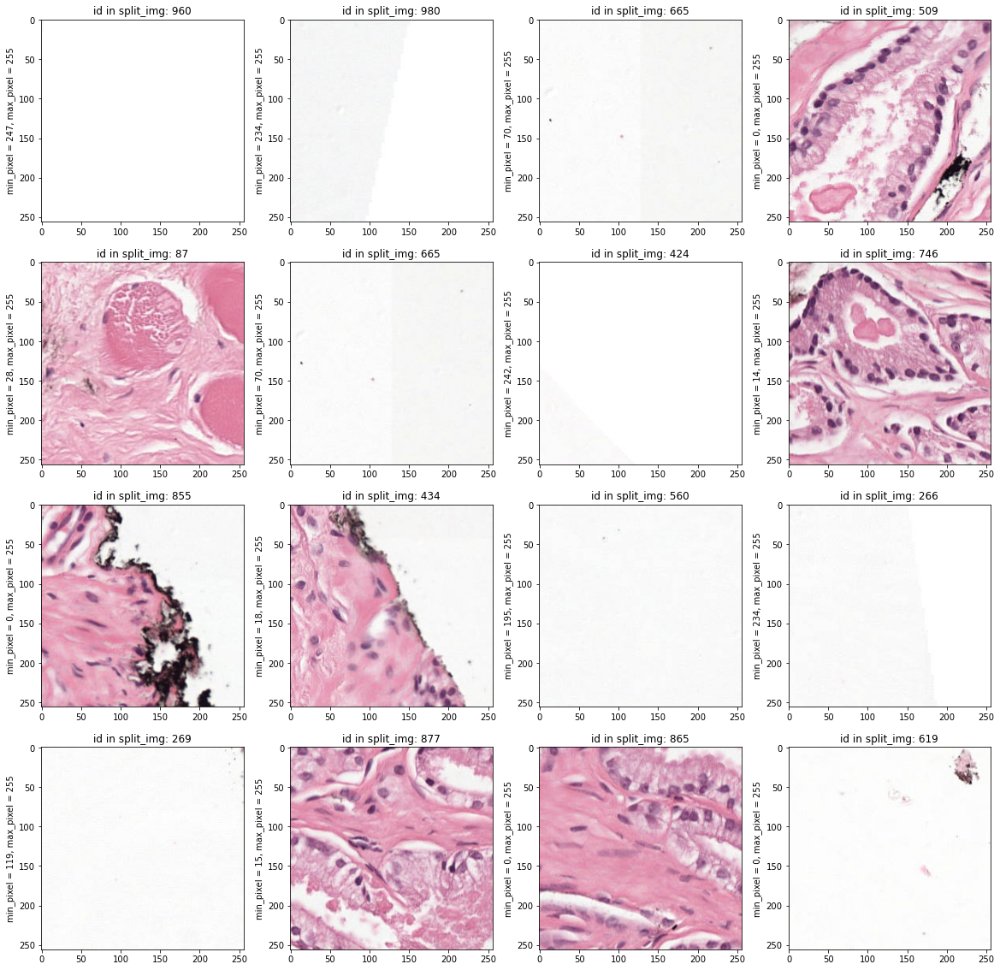

In [23]:
def test_and_count_time():
    plt.figure(figsize = (20, 20))
    for i in range(16):
        idx = np.random.randint(0, len(x))
        plt.subplot(4, 4, i + 1)
        plt.imshow(x[idx])
        plt.title('id in split_img: ' + str(idx))
        plt.ylabel('min_pixel = ' + str(x[idx].min()) + ', max_pixel = ' + str(x[idx].max()))
        
%time test_and_count_time()

**Comments.** The `white` pannels now are containing the `min_pixel` in (150, 253); to ignore this, we will add the condition values on min_pixel


#### spliting image version2, using `min_pixel_condition`

In [24]:
def spliting_image_v2(img, ws = 256, hs =256):
    """
    Input:  img : image source
            ws, hs : width_size & height_size per image
    return: list of images
    """
    h, w = img.shape[: 2]
    nc = int(w / ws)
    nr = int(h / hs)
    img_ls = []
    for i in range(nr):
        for j in range(nc):
            image = img[ int(i*hs) : int((i+1)*hs), int(j*ws) : int((j+1)*ws), :]
            if image.min() < 145:
                img_ls.append(image)
                
    return img_ls
        
y = spliting_image_v2(img, 256, 256)

In [25]:
len(y)

662

CPU times: user 16.6 s, sys: 127 ms, total: 16.7 s
Wall time: 16.8 s


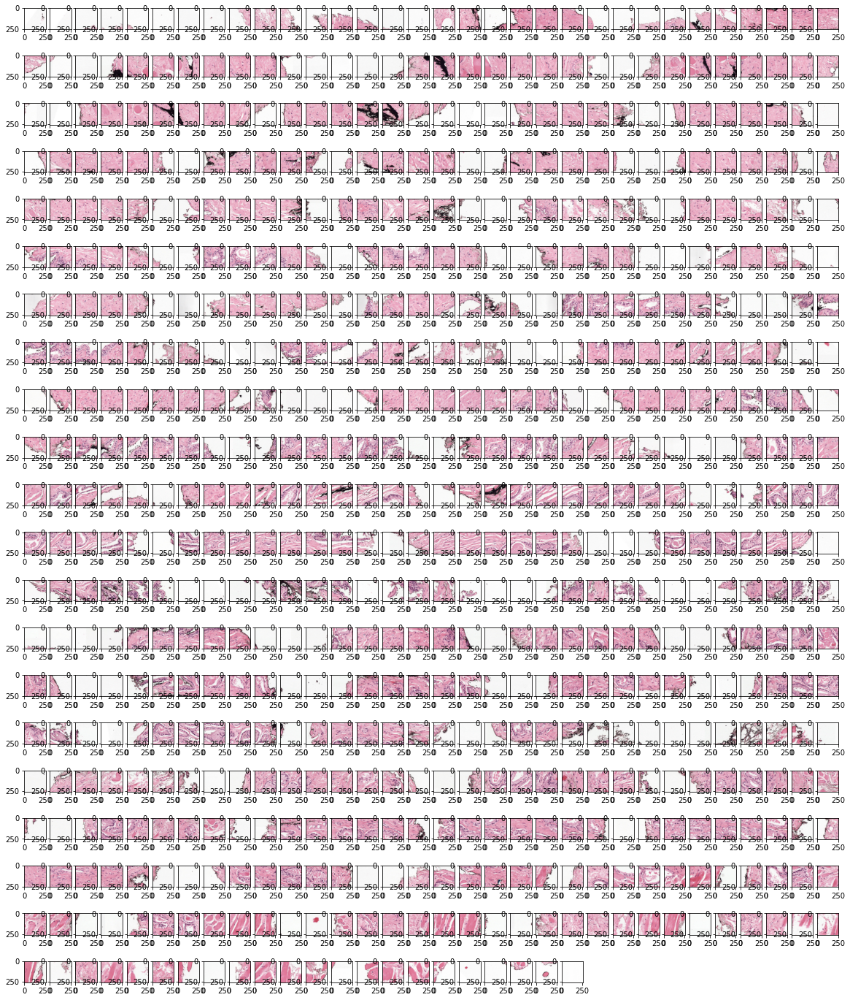

In [26]:
def test_and_count_time():
    plt.figure(figsize = (20, 25))
    for i in range(len(y)):
        plt.subplot(21, 32, i + 1)
        plt.imshow(y[i])
%time test_and_count_time()

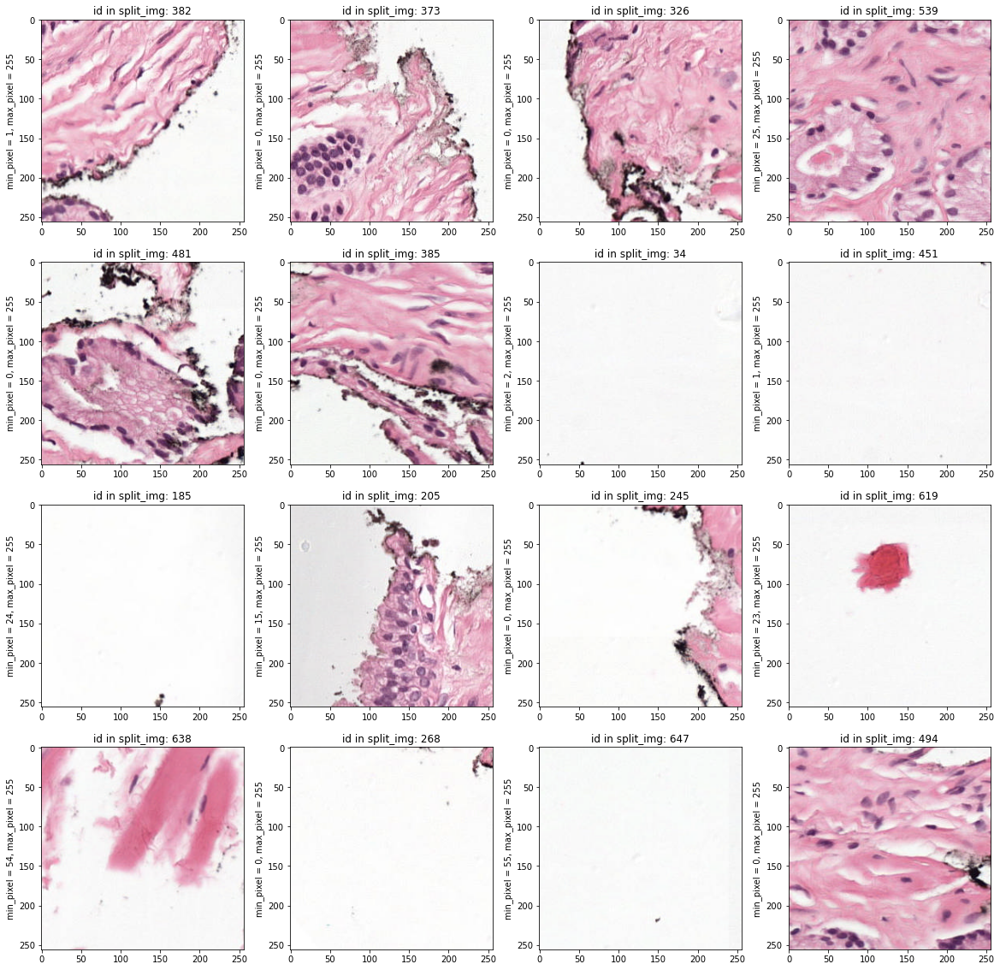

In [27]:
plt.figure(figsize = (20, 20))
for i in range(16):
    idx = np.random.randint(0, len(y))
    plt.subplot(4, 4, i + 1)
    plt.imshow(y[idx])
    plt.title('id in split_img: ' + str(idx))
    plt.ylabel('min_pixel = ' + str(y[idx].min()) + ', max_pixel = ' + str(y[idx].max()))

#### Using `black_color_criteria` to advoid the `white_panels`

Follow that, look at the preceding picture with the `id = 185` and `268`, we have observed that the ***in each `256 x 256 x 3` images, then the `non_bright_pixel_values` (which is lower than 50) doesn't exceed 900***, 

so I will take the `criteria` : 
*"if the prob(total_non_bright_pixel) > 0.0045, we will attach it, otherwise ignoring"*

In [39]:
z1 = y[185]
z2 = y[268]
print(len(z1[z1 <= 50]), len(z2[z2 <= 50]))
print(900/(256*256*3), 180/(256*256*3))

17 111
0.00457763671875 0.00091552734375


In [29]:
def spliting_image_v3(img, ws = 256, hs = 256, crit = 0.01):
    """
    Input:  img : image source
            ws, hs : width_size & height_size per image
    return: list of images
    """
    h, w = img.shape[: 2]
    nc = int(w / ws)
    nr = int(h / hs)
    img_ls = []
    for i in range(nr):
        for j in range(nc):
            image = img[ int(i*hs) : int((i+1)*hs), int(j*ws) : int((j+1)*ws), :]
            if (image.min() < 145):
                count = len(image[image <= 50])
                if count/(256*256*3) > crit:
                    img_ls.append(image)
                
    return img_ls
        
%time y2 = spliting_image_v3(img, 256, 256)
len(y2)

CPU times: user 732 ms, sys: 0 ns, total: 732 ms
Wall time: 733 ms


135

#### Randomly display split_img

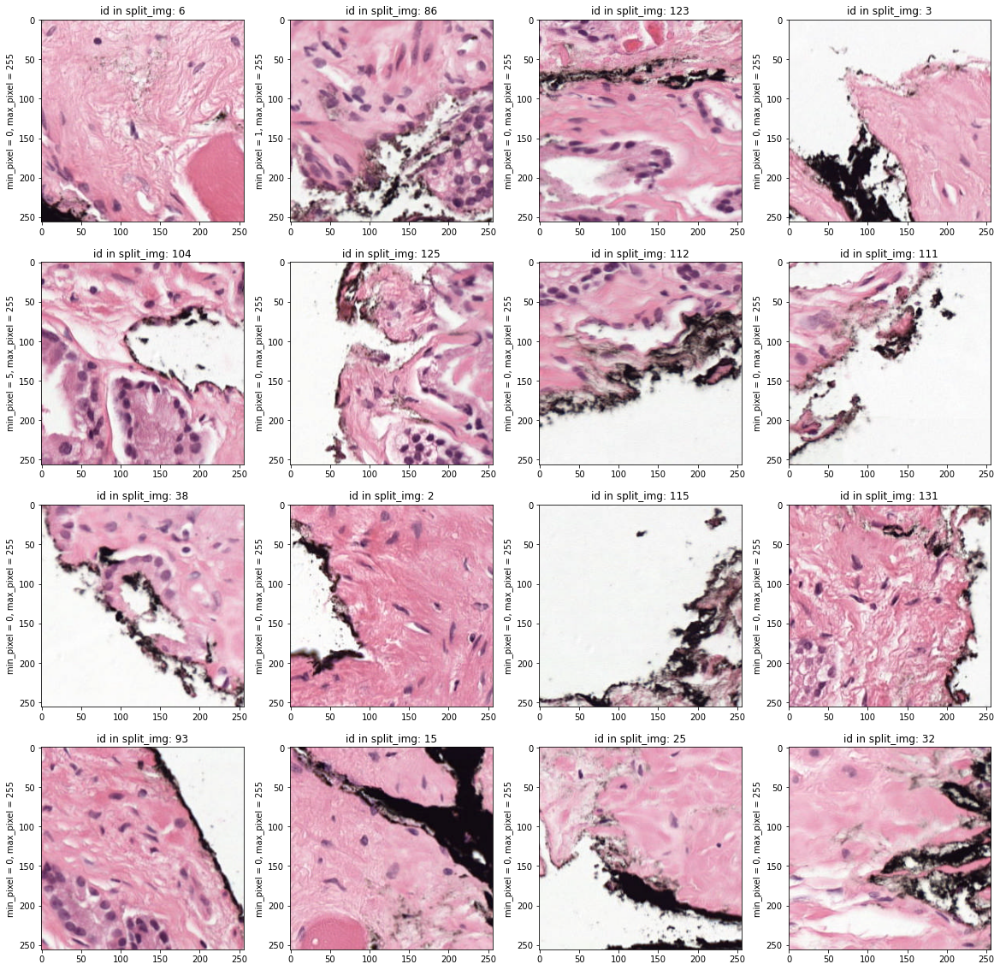

In [30]:
plt.figure(figsize = (20, 20))
for i in range(16):
    idx = np.random.randint(0, len(y2))
    plt.subplot(4, 4, i + 1)
    plt.imshow(y2[idx])
    plt.title('id in split_img: ' + str(idx))
    plt.ylabel('min_pixel = ' + str(y2[idx].min()) + ', max_pixel = ' + str(y2[idx].max()))

#### Display all split_images after using the `my_criteria`

CPU times: user 2.41 s, sys: 6.87 ms, total: 2.41 s
Wall time: 2.42 s


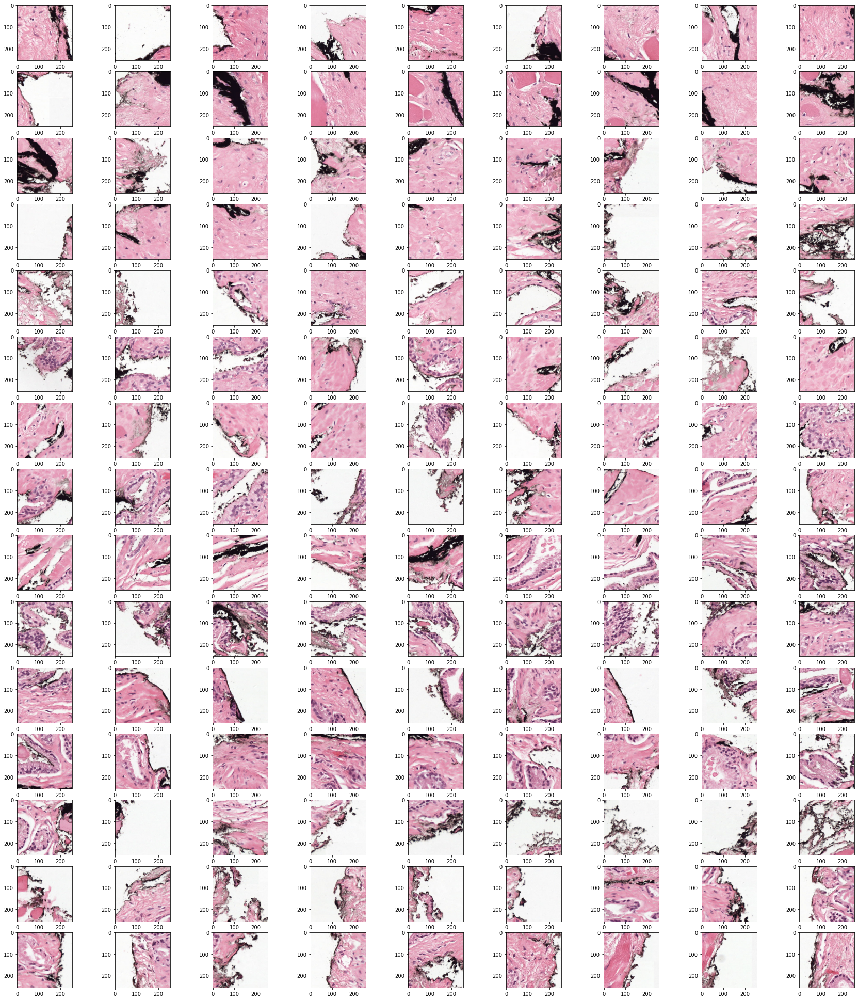

In [31]:
def test_and_count_time():
    plt.figure(figsize = (30, 35))
    for i in range(len(y2)):
        plt.subplot(15, 9, i + 1)
        plt.imshow(y2[i])
%time test_and_count_time()

### Build `get tiles` function with `n_tiles = 81`

In [32]:
def get_tiles(img, mode=0, tile_size = 256, n_tiles = 81):
        result = []
        h, w = img.shape[:2]
        pad_h = (tile_size - h % tile_size) % tile_size + ((tile_size * mode) // 2)
        pad_w = (tile_size - w % tile_size) % tile_size + ((tile_size * mode) // 2)

        img2 = np.pad(img,[[pad_h // 2, pad_h - pad_h // 2], [pad_w // 2,pad_w - pad_w//2], [0,0]], constant_values=255)
        img3 = img2.reshape(
            img2.shape[0] // tile_size,
            tile_size,
            img2.shape[1] // tile_size,
            tile_size,
            3
        )

        img3 = img3.transpose(0,2,1,3,4).reshape(-1, tile_size, tile_size,3)
        n_tiles_with_info = (img3.reshape(img3.shape[0],-1).sum(1) < tile_size ** 2 * 3 * 255).sum()
        if len(img) < n_tiles:
            img3 = np.pad(img3,[[0,N-len(img3)],[0,0],[0,0],[0,0]], constant_values=255)
        idxs = np.argsort(img3.reshape(img3.shape[0],-1).sum(-1))[:n_tiles]
        img3 = img3[idxs]
        for i in range(len(img3)):
            result.append({'img':img3[i], 'idx':i})
        return result, n_tiles_with_info >= n_tiles
    

%time z = get_tiles(img); type(z)

CPU times: user 1.29 s, sys: 205 ms, total: 1.49 s
Wall time: 1.49 s


tuple

In [33]:
type(z[0]), len(z[0]), type(z[-1]), type(z[0][1])

(list, 81, numpy.bool_, dict)

In [34]:
z[-1]

True

(256, 256, 3)


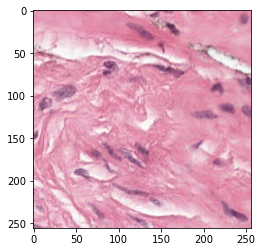

In [35]:
Z = z[0][80]
Z['img']
plt.imshow(Z['img'])
print(Z['img'].shape)

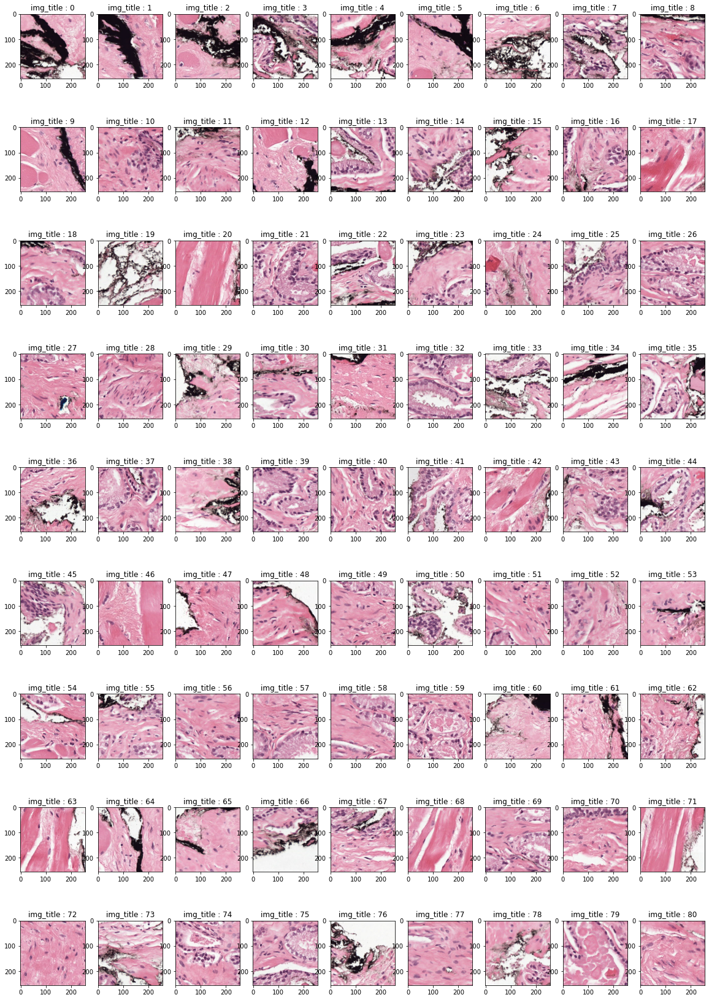

In [36]:
plt.figure(figsize = (20, 30))
for k in range(81):
    plt.subplot(9, 9, k + 1)
    plt.imshow(z[0][k]['img'])
    plt.title('img_title : ' + str(z[0][k]['idx']))

#### and for `n_tiles = 25`

In [37]:
%time z = get_tiles(img, 0, 512, 25); type(z)

CPU times: user 1.25 s, sys: 204 ms, total: 1.45 s
Wall time: 1.45 s


tuple

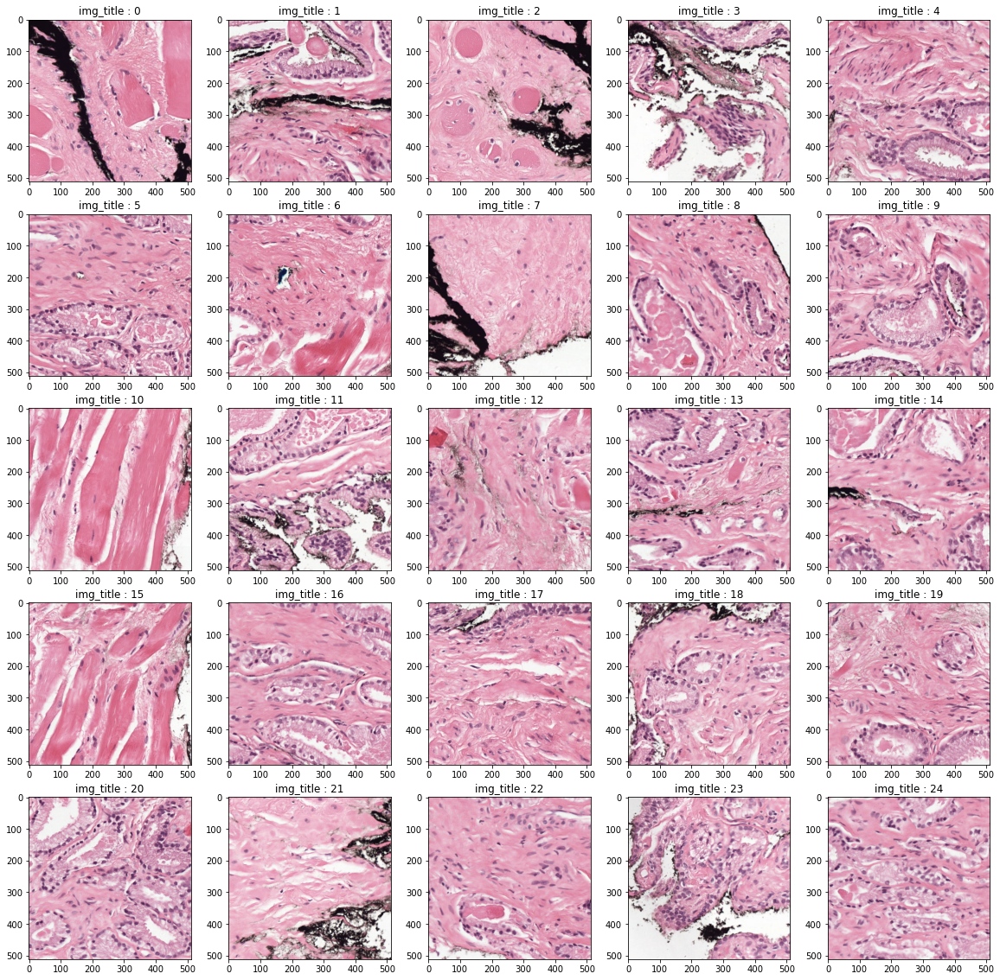

In [38]:
plt.figure(figsize = (20, 20))
for k in range(25):
    plt.subplot(5, 5, k + 1)
    plt.imshow(z[0][k]['img'])
    plt.title('img_title : ' + str(z[0][k]['idx']))